In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
import os
import time
import psutil

import torch
import torch.nn as nn
from torch import Tensor
import torch.optim as optim
from torch.distributions.normal import Normal
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torch.utils.data import SubsetRandomSampler

from sklearn.model_selection import train_test_split

import argparse
import random

import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

import matplotlib.animation as animation
from IPython.display import HTML

# 1. Carga de dataset

In [2]:
### CARGA DEL DATASET ### 

# ruta de los archivos
ruta_X = "./dataset_X.pt"
ruta_y = "./dataset_y.pt"

# Carga los archivos
X = torch.load(ruta_X)
y = torch.load(ruta_y)


In [3]:
X.shape

torch.Size([9156, 3, 64, 64])

# 2. EDA

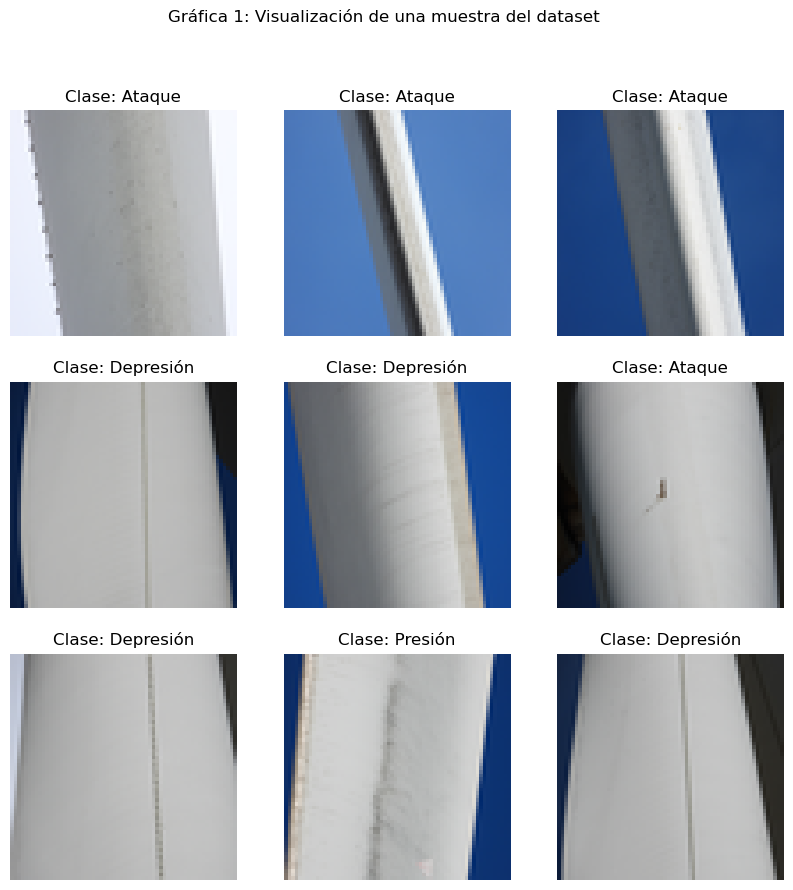

In [4]:
def mostrar_muestra_imagenes(X, y, clases, muestra=9):
    # Obtener índices aleatorios
    indices_muestra = torch.randperm(len(X))[:muestra]
    
    # Configurar el subplot
    fig, axs = plt.subplots(3, 3, figsize=(10, 10))
    
    for i, indice in enumerate(indices_muestra):
        # Obtener la imagen y la etiqueta correspondiente
        imagen = X[indice]
        etiqueta = y[indice].item()
        
        # Convertir la imagen a numpy y transponerla para que sea compatible con imshow
        imagen_numpy = imagen.permute(1, 2, 0).numpy()
        
        # Obtener la clase de la etiqueta
        clase = clases[etiqueta]
        
        # Mostrar la imagen en el subplot
        axs[i // 3, i % 3].imshow(imagen_numpy)
        axs[i // 3, i % 3].set_title(f"Clase: {clase}")
        axs[i // 3, i % 3].axis("off")
    
    plt.suptitle('Gráfica 1: Visualización de una muestra del dataset')

    plt.show()

# Defino las clases
etiquetas = ["Fuga", "Ataque", "Depresión", "Presión"]

# Grafica 1: muestra de 9 imágenes con sus etiquetas
mostrar_muestra_imagenes(X, y, etiquetas)

In [5]:
# Calcular total de imágenes en el dataset
num_total_imagenes = len(y)
print(f"Número total de imágenes: {num_total_imagenes}")

# Contar el número de imágenes por clase
clases, conteo = np.unique(y, return_counts=True)


for clase, num_imagenes in zip(clases, conteo):
    print(f"Clase {etiquetas[clase]}: {num_imagenes} imágenes")

Número total de imágenes: 9156
Clase Fuga: 2398 imágenes
Clase Ataque: 2370 imágenes
Clase Depresión: 2183 imágenes
Clase Presión: 2205 imágenes


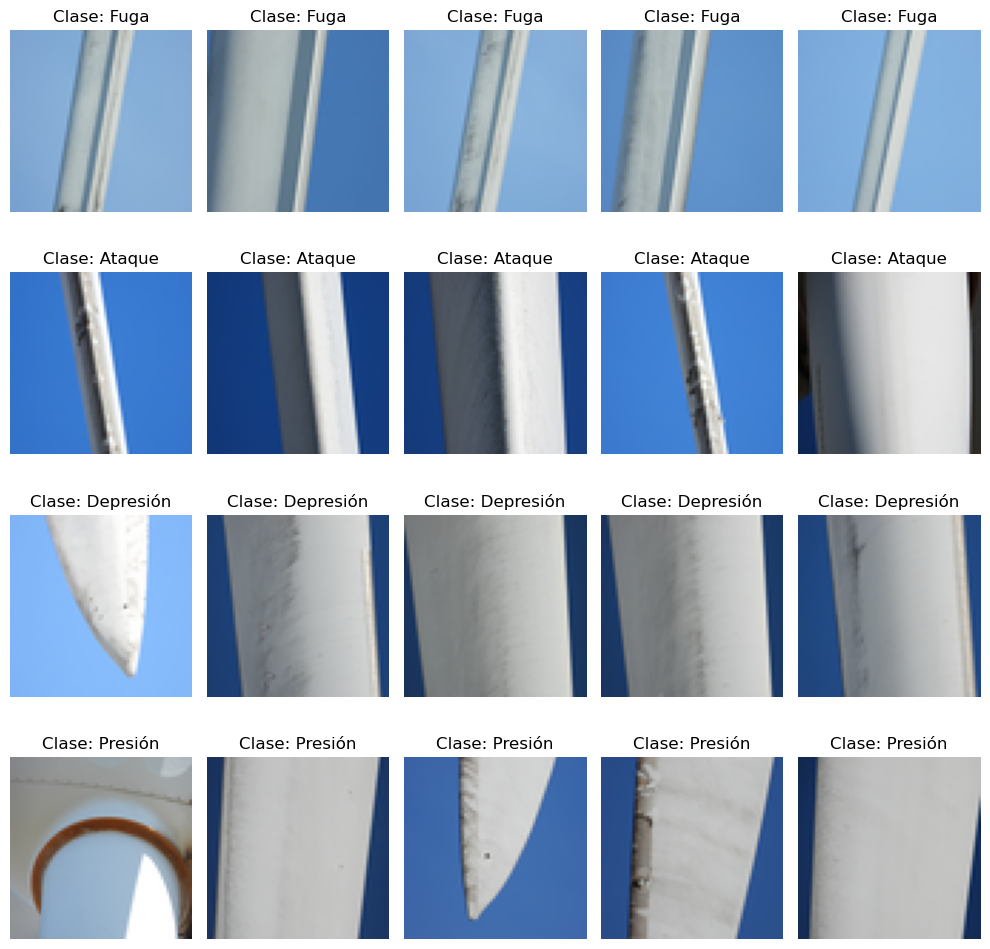

In [12]:
# Visualizar algunas muestras de imágenes
num_muestras_por_clase = 5
plt.figure(figsize=(10, 10))
for i, clase in enumerate(clases):
    indices_clase = np.where(y == clase)[0]
    muestras_clase = X[indices_clase[:num_muestras_por_clase]]
    for j in range(num_muestras_por_clase):
        plt.subplot(len(clases), num_muestras_por_clase, i * num_muestras_por_clase + j + 1)
        plt.imshow(muestras_clase[j].permute(1, 2, 0))
        plt.title(f'Clase: {etiquetas[clase]}')
        plt.axis('off')
plt.tight_layout()
plt.show()

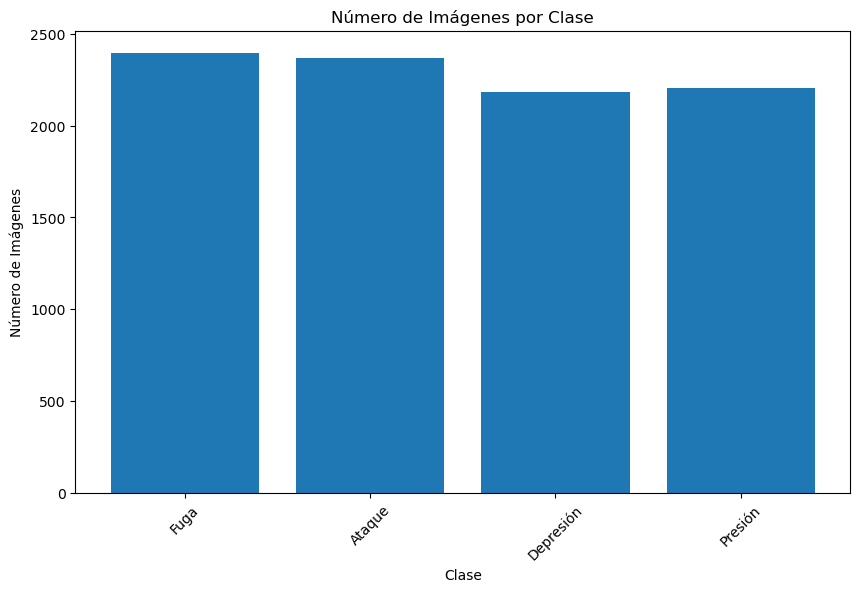

In [7]:
# Visualizar el conteo por clase
plt.figure(figsize=(10, 6))
plt.bar(clases, conteo)
plt.xlabel('Clase')
plt.ylabel('Número de Imágenes')
plt.title('Número de Imágenes por Clase')
plt.xticks(clases, [etiquetas[clase] for clase in clases], rotation=45)  # Especifica las etiquetas en el eje x
plt.show()



# 3. Preparación data

In [8]:
transform = transforms.Compose([#transforms.Resize((64, 64)),  # Redimensionar las imágenes a 64x64
                                transforms.Normalize(mean=[0.5],
                                std=[0.5])]
)

In [9]:
X.shape

torch.Size([9156, 3, 64, 64])

In [10]:
# Aplicar la transformación a tus datos X
dataset = torch.stack([transform(x) for x in X])

# Crear un TensorDataset
dataset = TensorDataset(dataset)

# Definir el tamaño del lote (batch size)
batch_size = 128

# Crear el DataLoader
data_loader = DataLoader(dataset, 
                        batch_size=batch_size, 
                        num_workers=4,
                        drop_last=True)

In [11]:
# Verifico el tamaño del dataloaders
print("Tamaño del dataloader de entrenamiento:", len(data_loader))


# Verificar el tamaño de los lotes en cada dataloader
for i, inputs in enumerate(data_loader):
    print("Tamaño del lote {} del dataloader de entrenamiento:".format(i+1))
    for input_tensor in inputs:
        print("Tamaño del tensor de entrada:", input_tensor.shape)
    break  # Solo mostramos el tamaño del primer lote



Tamaño del dataloader de entrenamiento: 71
Tamaño del lote 1 del dataloader de entrenamiento:
Tamaño del tensor de entrada: torch.Size([128, 3, 64, 64])


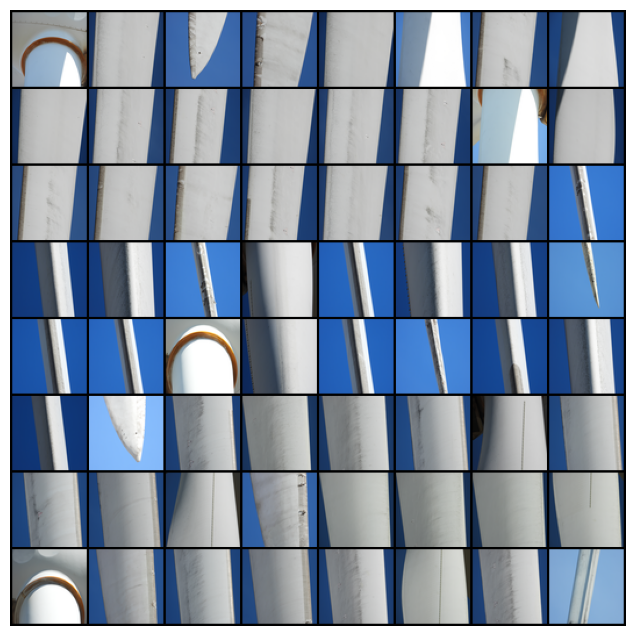

In [13]:
# graficar imagenes reales
real_batch = next(iter(data_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
#plt.title("Imágenes de entrenamiento")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# 4. DCGAN

In [13]:
# Definir la semilla para Torch y NumPy
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
torch.use_deterministic_algorithms(True) # Necesaria para reproducir resultados
# definir device
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [14]:
# funcion auxiliar pra iniciar pesos
def pesos_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [15]:
###### variables de entrada ###### 

image_size = 64

# canales - coor 3
nc = 3

# vector del espacio latente 
nz = 100

# filtros del generador
ngf = 64

# filtros del dicscriminador
ndf = 64

# Learning rate
lr = 0.0002

# parámetro para ADAM
beta1 = 0.5

## 4.1 Generador

In [16]:
### Generador de la DCGAN ####

class Generador(nn.Module):
    def __init__(self):
        super(Generador, self).__init__()

        self.main = nn.Sequential(
            # entrda z de espacio latente
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # salida: (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [17]:
# Creo el modelo
netG = Generador().to(device)

# inicio los pesos
netG.apply(pesos_init)

print(netG)

Generador(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## 4.2 Discriminador

In [18]:
### Discriminador DCGAN ###

class Discriminador(nn.Module):
    def __init__(self):
        super(Discriminador, self).__init__()

        self.main = nn.Sequential(
            # entrada (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid() #salida de 0 a 1
        )

    def forward(self, input):
        return self.main(input)



In [19]:
 #Creao el modelo Discriminador
netD = Discriminador().to(device)

netD.apply(pesos_init)

# Print the model
print(netD)

Discriminador(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## 4.4 Entrenamiento

In [20]:
# función de pérdida "Binary Cross Entropy Loss"
DCGAN_Loss = nn.BCELoss()

# vectores del espacio latente para evaluar el generador
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# etiquetas
real_label = 1.
fake_label = 0.

# Adam optimizer
optimD_DC = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimG_DC = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


In [21]:
### ENTRENAMIENTO ###

num_epochs = 100
img_list = []
G_DC_loss = []
D_DC_loss = []
iters = 0

DCGAN_accuracy = []  # acc del discriminador

print("Iniciando el entrenamiento...")
# Tiempo de inicio
start_time = time.time()

for epoch in range(num_epochs):
    # itero sobre cada batch del dataloader
    for i, data in enumerate(data_loader, 0):
        
        ######## DISCRIMINADOR ##########
        #inicializo gradiente
        netD.zero_grad()

        lote = data[0].to(device) #obtener batch
        b_size = lote.size(0) #tamaño del batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # propago el batch real en el discriminador
        output = netD(lote).view(-1)

        # Calculo la pérdida
        errD_real = DCGAN_Loss(output, label)
        # backpropagation
        errD_real.backward()

        ## Entreno con muestras fake
        # Genero vectores del espacio latente
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Genero  fake image y etiqueto
        fake = netG(noise)
        label.fill_(fake_label)
        # paso el fake batch por el discriminador
        output = netD(fake.detach()).view(-1)

        # Calculo pérdida
        errD_fake = DCGAN_Loss(output, label)
        # backpropagation
        errD_fake.backward()
        
        # determino el error de D
        errD = errD_real + errD_fake
        # actualizo Discriminador
        optimD_DC.step()

        ############ GENERADOR ##########
        netG.zero_grad()
        label.fill_(real_label)  
        # paso fake por el discriminador
        output = netD(fake).view(-1)
        # Calcuo pérdida del generador
        errG = DCGAN_Loss(output, label)
        # backpropagation
        errG.backward()
        # Actualizo generador
        optimG_DC.step()
        
        
        if i % 50 == 0:
            #calculo ACC del discriminador
            with torch.no_grad():
                # Clasificar imágenes reales
                real_output = netD(lote).view(-1)
                real_preds = (real_output > 0.5).long()  
                correct_real = torch.sum(real_preds == 1).item()  
                # Clasificar imágenes falsas
                fake_output = netD(fake.detach()).view(-1)
                fake_preds = (fake_output <= 0.5).long()  
                correct_fake = torch.sum(fake_preds == 0).item()  
                # Calcular acc
                total_correct = correct_real + correct_fake
                total = len(real_output) + len(fake_output)
                accuracy = total_correct / total

                DCGAN_accuracy.append(accuracy)    

            # imprimo pérdida en Gen y Disc y acc    
            print('Época[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tAccuracy_Disc: %.4f'
                    % (epoch, num_epochs, i, len(data_loader),
                        errD.item(), errG.item(), accuracy))
        
        # Save Losses for plotting later
        G_DC_loss.append(errG.item())
        D_DC_loss.append(errD.item())
        
        # Guardo imágenes generadas duranyte entrenamiento para ver evolución
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1


# Tiempo final
end_time = time.time()

# Cantidad de parámetros de la red
total_params = sum(p.numel() for p in netG.parameters() if p.requires_grad)

# Tiempo total transcurrido
elapsed_time = end_time - start_time

print('Entrenamiento finalizado.\n\tParámetros de red: %d\tTiempo total transcurrido: %.2f s'
      % (total_params, elapsed_time))


# Obtener la memoria utilizada en bytes
mem_usage = psutil.virtual_memory().used

# Convertir a megabytes
mem_usage_mb = mem_usage / (1024 * 1024)

print("Memoria utilizada:", mem_usage_mb, "MB")


Iniciando el entrenamiento...


Época[0/100][0/71]	Loss_D: 1.6302	Loss_G: 3.5193	Accuracy_Disc: 0.4883
Época[0/100][50/71]	Loss_D: 1.2662	Loss_G: 21.2821	Accuracy_Disc: 0.4727
Época[1/100][0/71]	Loss_D: 0.1042	Loss_G: 18.2201	Accuracy_Disc: 0.4961
Época[1/100][50/71]	Loss_D: 0.6973	Loss_G: 5.6437	Accuracy_Disc: 0.5000
Época[2/100][0/71]	Loss_D: 0.5150	Loss_G: 4.7060	Accuracy_Disc: 0.5000
Época[2/100][50/71]	Loss_D: 0.0423	Loss_G: 7.2097	Accuracy_Disc: 0.5000
Época[3/100][0/71]	Loss_D: 0.1160	Loss_G: 7.6240	Accuracy_Disc: 0.4922
Época[3/100][50/71]	Loss_D: 0.0637	Loss_G: 5.1667	Accuracy_Disc: 0.5000
Época[4/100][0/71]	Loss_D: 0.2945	Loss_G: 4.1555	Accuracy_Disc: 0.5352
Época[4/100][50/71]	Loss_D: 0.1753	Loss_G: 6.6384	Accuracy_Disc: 0.4961
Época[5/100][0/71]	Loss_D: 0.4034	Loss_G: 7.0748	Accuracy_Disc: 0.4727
Época[5/100][50/71]	Loss_D: 0.1370	Loss_G: 4.7184	Accuracy_Disc: 0.5000
Época[6/100][0/71]	Loss_D: 1.4590	Loss_G: 16.9336	Accuracy_Disc: 0.0117
Época[6/100][50/71]	Loss_D: 0.0897	Loss_G: 4.1990	Accuracy_Disc: 0.5

## Visualizaciones

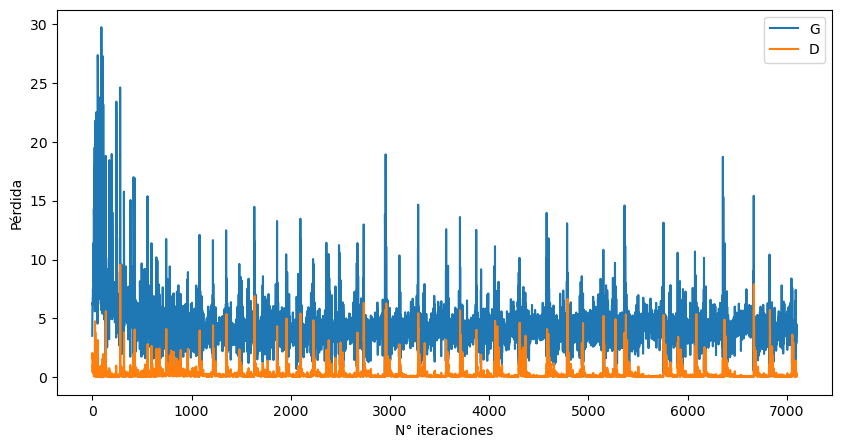

In [22]:
plt.figure(figsize=(10,5))
#plt.title("Pérdidas D y G")
plt.plot(G_DC_loss,label="G")
plt.plot(D_DC_loss,label="D")
plt.xlabel("N° iteraciones")
plt.ylabel("Pérdida")
plt.legend()
plt.show()

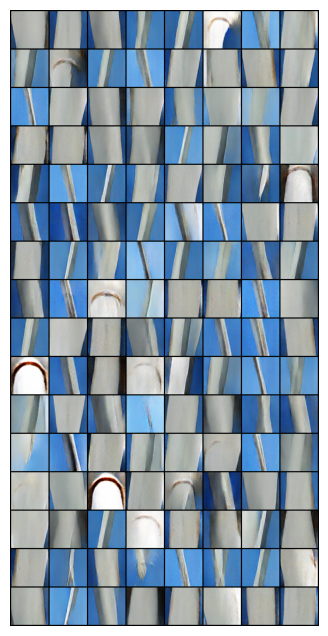

In [23]:
#####Visualización de la progersión del generador ##############

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

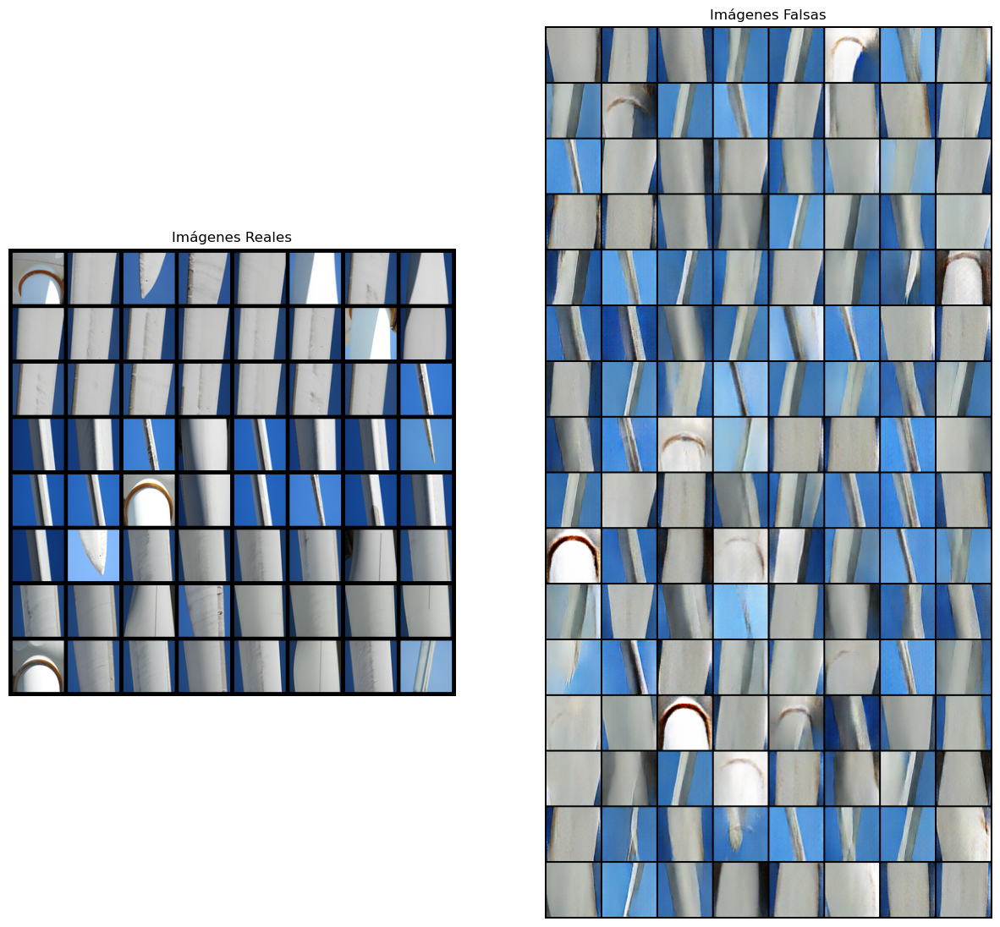

In [24]:
# cargo un lote de imagenes reales
real_batch = next(iter(data_loader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Imágenes Reales")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Imágenes Falsas")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## Guardar modelo

In [25]:
# Guardar el modelo generador y el modelo discriminador
torch.save(netG.state_dict(), 'generadorDCGAN.pth')
torch.save(netD.state_dict(), 'discriminadorDCGAN.pth')

# Guardar las imágenes falsas generadas en la última época
torch.save(img_list[-1], 'fake_images_DCGAN.pth')


## Evaluación de la DCGAN

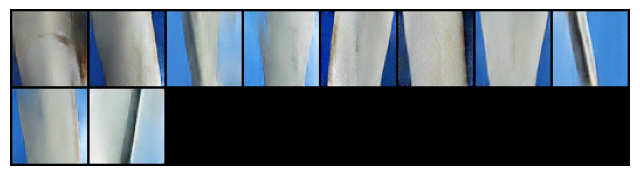

In [26]:
# Cargar los parámetros del generador desde el archivo guardado
netG.load_state_dict(torch.load('generadorDCGAN.pth'))

# Generar imágenes falsas
with torch.no_grad():
    noise = torch.randn(10, nz, 1, 1)
    fake_images = netG(noise)

# Visualizar las imágenes generadas
plt.figure(figsize=(8, 8))
plt.axis("off")
#plt.title("Imágenes falsas generadas por el generador")
plt.imshow(np.transpose(vutils.make_grid(fake_images, padding=2, normalize=True), (1, 2, 0)))
plt.show()


# LSGAN


In [27]:
### variables de entrada 

image_size = 64

# canales - coor 3
nc = 3

# vector del espacio latente 
nz = 100

# filtros del generador
ngf = 64

# filtros del dicscriminador
ndf = 64

# Learning rate
lr = 0.001

# parámetro para ADAM optimizador
beta1 = 0.5

## Generador

In [28]:
# Generator Code

class Generador_LSGAN(nn.Module):
    def __init__(self):
        super(Generador_LSGAN, self).__init__()
        
        self.main = nn.Sequential(
            # entrada: z espacio latente
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # tamaño ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # tamaño. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # tamaño. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # tamaño. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # tamaño. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [29]:
# Creo el gen_LSGA
netG_LS = Generador_LSGAN().to(device)

# inicializo pesos
#  ``mean=0``, ``stdev=0.02``.
netG_LS.apply(pesos_init)

# Print the model
print(netG_LS)

Generador_LSGAN(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()


## Discriminador

la capa sigmoide se va y entrta una capa lineal

In [30]:
# Discriminador LSGAN

class Discriminador_LSGAN(nn.Module):
    def __init__(self):
        super(Discriminador_LSGAN, self).__init__()

        self.main = nn.Sequential(
            # entrada ``3 x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # tamaño ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # tamaño ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # tamaño ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False)

        )

    def forward(self, input):
        return self.main(input)



In [31]:
 #Creo el discriminador
netD_LS = Discriminador_LSGAN().to(device)

# inicializo los pesos
netD_LS.apply(pesos_init)

# Print the model
print(netD_LS)

Discriminador_LSGAN(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)


## Entrenamiento

In [32]:
# Función de pérdida mínimos cuadrados

LSGAN_loss = torch.nn.MSELoss()

# vectores del espacio latente para evaluar el generador
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

real_label = 1.
fake_label = 0.

# Adam optimizer
optimD_LS = optim.Adam(netD_LS.parameters(), lr=lr, betas=(beta1, 0.999))
optimG_LS = optim.Adam(netG_LS.parameters(), lr=lr, betas=(beta1, 0.999))

In [33]:
# loop de entrenamiento

num_epochs = 100
img_list_LS = []
G_LS_loss = []
D_LS_loss = []
iters = 0

LSGAN_accuracy = []

print("Iniciando el entrenamiento...")
# Tiempo de inicio
start_time = time.time()

for epoch in range(num_epochs):
    # itero sobre cada batch del dataloader
    for i, data in enumerate(data_loader, 0):
        
        ######## DISCRIMINADOR ##########
        #inicializo gradiente
        netD_LS.zero_grad()

        lote = data[0].to(device) #obtener batch
        b_size = lote.size(0) #tamaño del batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) #etiqueto el lote
        #print('label', label.shape)
        # propago el batch real en el discriminador
        output = netD_LS(lote).view(-1)
        #print('output', output.shape)  
        
        # Calculo pérdida
        errD_real = LSGAN_loss(output, label)
        # backpropagation
        errD_real.backward()

        ## Entreno con muestras fake
        # Genero vectores del espacio latente
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Genero  fake image y etiqueto
        fake = netG_LS(noise)
        label.fill_(fake_label)
        # paso el fake batch por el discriminador
        output = netD_LS(fake.detach()).view(-1)
        # calculo la pérdida
        errD_fake = LSGAN_loss(output, label)
        # backpropagation
        errD_fake.backward()
        # determino el error de D
        errD = 0.5*(errD_real + errD_fake)
        # actualizo Discriminador
        optimD_LS.step()

        ############ GENERADOR ##########
        netG_LS.zero_grad()
        label.fill_(real_label)  
        # paso fake por el discriminador
        output = netD_LS(fake).view(-1)
        # Calcuo pérdida del generador
        errG = LSGAN_loss(output, label)
        # backpropagation
        errG.backward()

        # Actualizo generador
        optimG_LS.step()
        
        
        if i % 50 == 0:
#calculo ACC del discriminador
            with torch.no_grad():
                # Clasificar imágenes reales
                real_output = netD(lote).view(-1)
                real_preds = (real_output > 0.5).long()  
                correct_real = torch.sum(real_preds == 1).item()  
                # Clasificar imágenes falsas
                fake_output = netD(fake.detach()).view(-1)
                fake_preds = (fake_output <= 0.5).long()  
                correct_fake = torch.sum(fake_preds == 0).item()  
                # Calcular acc
                total_correct = correct_real + correct_fake
                total = len(real_output) + len(fake_output)
                accuracy = total_correct / total

                LSGAN_accuracy.append(accuracy)    

            # imprimo pérdida en Gen y Disc y acc    
            print('Época[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tAccuracy_Disc: %.4f'
                    % (epoch, num_epochs, i, len(data_loader),
                        errD.item(), errG.item(), accuracy))

        
        # Guardo pérdidas
        G_LS_loss.append(errG.item())
        D_LS_loss.append(errD.item())
        
        # Guardo imágenes generadas durante entrenamiento para ver evolución
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = netG_LS(fixed_noise).detach().cpu()
            img_list_LS.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

# Tiempo final
end_time = time.time()

# Cantidad de parámetros de la red
total_params = sum(p.numel() for p in netG.parameters() if p.requires_grad)

# Tiempo total transcurrido
elapsed_time = end_time - start_time

print('Entrenamiento finalizado.\n\tParámetros de red: %d\tTiempo total transcurrido: %.2f s'
      % (total_params, elapsed_time))


# Obtener la memoria utilizada en bytes
mem_usage = psutil.virtual_memory().used

# Convertir a megabytes
mem_usage_mb = mem_usage / (1024 * 1024)

print("Memoria utilizada:", mem_usage_mb, "MB")


Iniciando el entrenamiento...
Época[0/100][0/71]	Loss_D: 1.7576	Loss_G: 558.7404	Accuracy_Disc: 0.5000
Época[0/100][50/71]	Loss_D: 0.2130	Loss_G: 2.8744	Accuracy_Disc: 0.5000
Época[1/100][0/71]	Loss_D: 0.2664	Loss_G: 3.7770	Accuracy_Disc: 0.5000
Época[1/100][50/71]	Loss_D: 0.0659	Loss_G: 1.1026	Accuracy_Disc: 0.5000
Época[2/100][0/71]	Loss_D: 0.0751	Loss_G: 1.1208	Accuracy_Disc: 0.5000
Época[2/100][50/71]	Loss_D: 0.0282	Loss_G: 1.0757	Accuracy_Disc: 0.5000
Época[3/100][0/71]	Loss_D: 0.0868	Loss_G: 0.6396	Accuracy_Disc: 0.5000
Época[3/100][50/71]	Loss_D: 0.0524	Loss_G: 0.8775	Accuracy_Disc: 0.5000
Época[4/100][0/71]	Loss_D: 0.1455	Loss_G: 1.5210	Accuracy_Disc: 0.5000
Época[4/100][50/71]	Loss_D: 0.1181	Loss_G: 0.5325	Accuracy_Disc: 0.5000
Época[5/100][0/71]	Loss_D: 0.0961	Loss_G: 1.0771	Accuracy_Disc: 0.5000
Época[5/100][50/71]	Loss_D: 0.0731	Loss_G: 0.7466	Accuracy_Disc: 0.5000
Época[6/100][0/71]	Loss_D: 1.4644	Loss_G: 4.6672	Accuracy_Disc: 0.5000
Época[6/100][50/71]	Loss_D: 0.0954	Loss

## Vsualizaciones

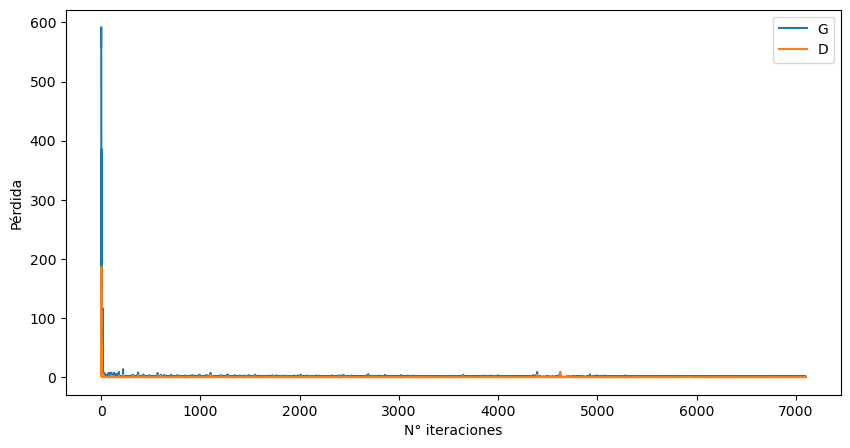

In [34]:
plt.figure(figsize=(10,5))
#plt.title("Pérdidas durtante entrenamiento")
plt.plot(G_LS_loss,label="G")
plt.plot(D_LS_loss,label="D")
plt.xlabel("N° iteraciones")
plt.ylabel("Pérdida")
plt.legend()
plt.show()

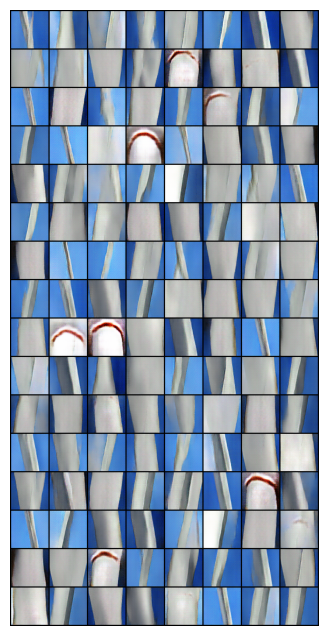

In [35]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_LS]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

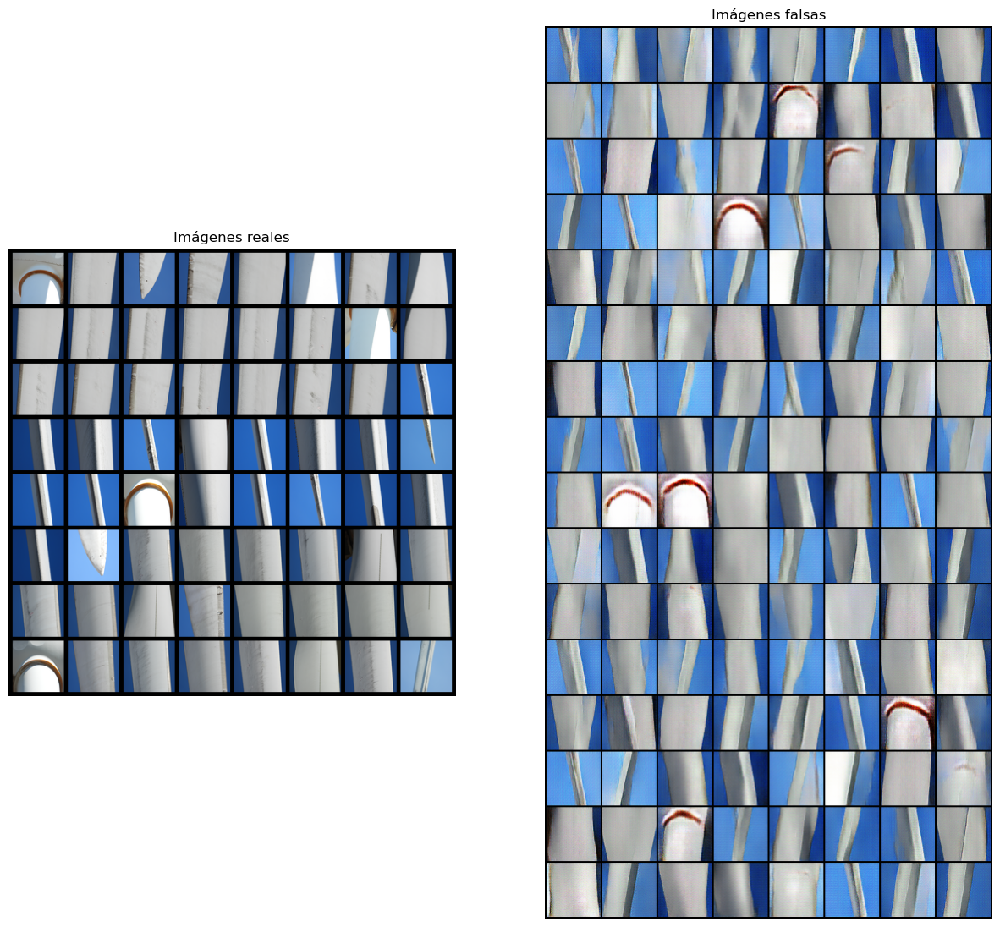

In [36]:
real_batch = next(iter(data_loader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Imágenes reales")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Imágenes falsas")
plt.imshow(np.transpose(img_list_LS[-1],(1,2,0)))
plt.show()

## Guardar modelo y evaluar

In [37]:
# Guardar el modelo generador y el modelo discriminador
torch.save(netG_LS.state_dict(), 'generadorLSGAN.pth')
torch.save(netD_LS.state_dict(), 'discriminadorLSGAN.pth')

# Guardar las imágenes falsas generadas en la última época
torch.save(img_list_LS[-1], 'fake_images_LSGAN.pth')

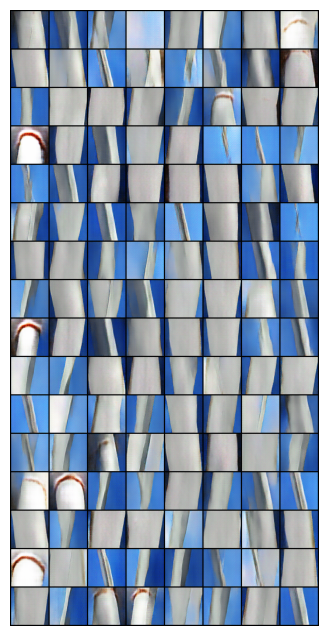

In [38]:
# Cargar los parámetros del generador desde el archivo guardado
netG_LS.load_state_dict(torch.load('generadorLSGAN.pth'))

# Generar imágenes falsas
with torch.no_grad():
    noise = torch.randn(batch_size, nz, 1, 1)
    fake_images = netG_LS(noise)

# Visualizar las imágenes generadas
plt.figure(figsize=(8, 8))
plt.axis("off")
#plt.title("Fake Images")
plt.imshow(np.transpose(vutils.make_grid(fake_images, padding=2, normalize=True), (1, 2, 0)))
plt.show()